<a href="https://colab.research.google.com/github/ShiwangiMishra-Git/DeepLearningFinalProject/blob/main/MobileNet_%2B_SSD_Project_Report.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Object detection Using MobileNet + SSD**
### Project Report - Intro to Machine Learning

 Shiwangi Mishra (sm9175@nyu.edu);
Saili Kulkarni (snk9486@nyu.edu)



**Introduction:**

The main objective of this project report is to demonstrate the analysis of the MobileNet-SSD model which is a Single-Shot Multibox Detection (SSD) network intended to perform object detection. We studied this state of the art method and performed a comparative analysis with other methods (For eg. R-CNN) this technique was meant to improve upon.


**Motivation:**

Object detection is one of the most prominent fields of research in computer vision today. It is an extension of image classification, where the goal is to identify the class of one or more objects in an image and localize the object presence with the help of bounding boxes. Intuitively, we can understand that this is extremely useful and object detection is indeed applied in many areas of computer vision, including image retrieval, security, surveillance, automated license plate recognition, optical character recognition, traffic control, medical and agricultural applications and many more.


**Object Detection :** 
![](https://drive.google.com/uc?export=view&id=1naF5O_xI4OzjmSHWNe6mFL0-WJusmLb6)

Classic object detectors were based on a sliding window approach, which is computationally intensive due to the exhaustive search and was rendered obsolete by the rise of region proposal techniques(R-CNN, Fast R-CNN). This approach uses a selective search for finding regions of interest in the image based on image properties like texture, color intensity etc. for detecting objects. This reduces the computation since now only a set number of regions have to be processed per image and performs relatively better but has its constraints. The search algorithm is a decoupled process from training and this includes the risk of generating false positives. Also, since this technique also involves processing of a region at a time for detecting objects, it is computationally slow and expensive, achieving 73.2 mAP on the Pascal VOC2007 test set (Faster R-CNN), but remaining considerably slow for real-time detection applications with 7 fps. This isn't suitable for fast object detection.



**Selective Search for finding ROIs :** 
![](https://drive.google.com/uc?export=view&id=1VBM6NNZYOroUnd1pI97Y4gQpojlV3MMv)

**Region Proposal Pipeline :**
![](https://drive.google.com/uc?export=view&id=1HlJkWFnNC_MOb_Le6zz4EkFg1pm1TwwC)

The next significant improvement in the history of object detection was to drop region proposal step altogether and predict bounding box coordinates and confidence class scores directly from the image in one network after sampling it once. These are referred to as single stage detectors and their structural simplicity enables real-time predictions. One of the implementations of this technique is You Only Look Once (YOLO). This method samples the image only once before and extracts features before dividing it into a grid and predicting outcomes for each cell using fully connected layers. This is a fast process, achieving 21 fps and an accuracy of 66.4 mAP on the Pascal VOC2007 test set. However, by increasing speed we risk reducing the accuracy of the detector and this reframes the detection question as to how the speed vs accuracy trade-off can be further improved.

**YOLO :** 
![](https://drive.google.com/uc?export=view&id=1NDUaTkgxytPZjo8SnagYOb2n30B2MNNb)


The Single Shot Multibox detector, which is the subject of this report was introduced to provide a good balance of speed and accuracy required for fast object detection. SSD Multibox detector used VGG-16 as a base network, it achieved a speed comparable to that of YOLO and an accuracy comparable to that of Faster-RCNN with 74.3 mAP on the Pascal VOC2007 test set. Training and inference time was further improved by a light weight MobileNet network (SSD-Mobilnet) as a replacement for VGG-16 that reduced the computation time while keeping the accuracy similar.

In this report we have summarized our understanding of the architecture and working of SSD+Mobilenet and also compared it to the Faster R-CNN method as part of our extension of the initial subject matter provided to us. We have also highlighted the strengths and weaknesses of SSD as part of this extension.

Data Sets:

Our model is a SSD-based object detection model trained on Open Images V4 with ImageNet pre-trained MobileNet V2 as image feature extractor.







Image Source : [R-CNN](https://jonathan-hui.medium.com/what-do-we-learn-from-region-based-object-detectors-faster-r-cnn-r-fcn-fpn-7e354377a7c9), [YOLO](https://cv-tricks.com/object-detection/faster-r-cnn-yolo-ssd/), [Object Detection](https://towardsdatascience.com/object-detection-using-google-ai-open-images-541ea601cfa5)

#**Model Architecture - Single Shot MultiBox Detector (VGG16 + SSD)**

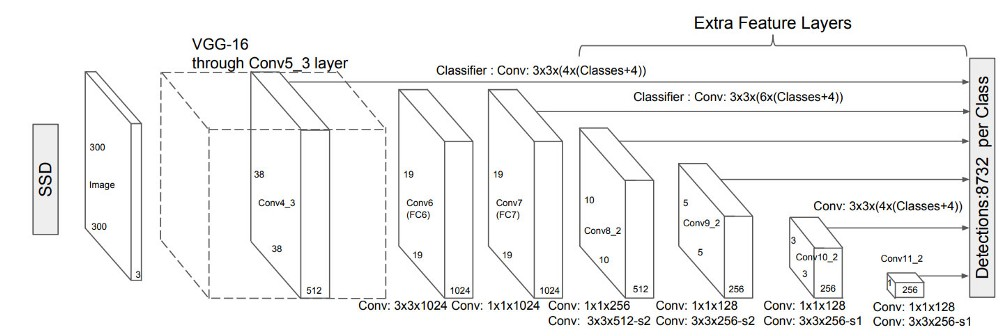


[Image Source - SSD: Single Shot MultiBox Detector (VGG16 + SSD)](https://www.researchgate.net/figure/mobileNet-SSD-network-architecture_fig3_332553794)

The SSD object detection is composed of two major parts:

* Extract feature maps using convolutional layers
* Apply convolution filters to detect objects


# **Extract feature maps**



**VGG16:** A VGG-16 model, pre-trained on ImageNet for image classification, is used as the backbone network. However, a few changes were made when adapting the model for the detection task, that included replacing the fully connected layers with convolutional implementations, removing dropout layers, and replacing the last max pooling layer with a dilated convolution.

SSD uses VGG16 to extract feature maps. However, it adds additional feature extraction convolutional layers as shown in the figure below. It uses predictions from features from different layers to provide an accurate prediction for objects of different scales. Hence, even without the region proposal step it is able to perform well.


![](https://drive.google.com/uc?export=view&id=1A7tnWF5T_lAFg4wbT3MwT1VgoNTQWck_)

![](https://drive.google.com/uc?export=view&id=18RSK_SlpcaFNvvYCT-JWnEf2eDpSSeiP)



Image Source : [SSD](https://towardsdatascience.com/understanding-ssd-multibox-real-time-object-detection-in-deep-learning-495ef744fab)

# **Detection**

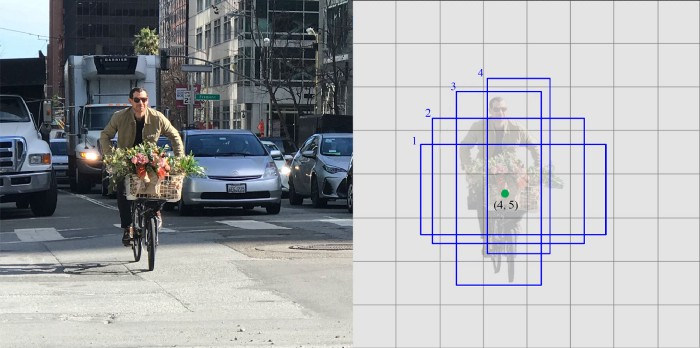

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

Several default anchor boxes are used with respect to which the predictions are made as seen in the image above. This helps in detecting objects of different sizes and shapes. This is referred to as the multibox technique.

# **Apply convolution filters to detect objects**

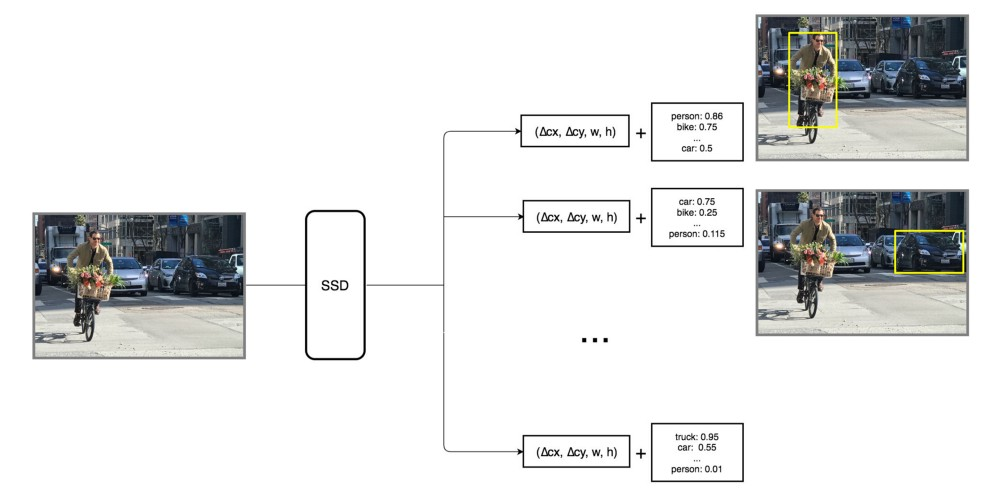

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**Convolutional predictors for object detection :** SSD does not use a delegated region proposal network. Instead, it uses a very simple method. It computes both the location offsets with respect to default bounding boxes and class scores using small convolution filters. After extracting the feature maps, SSD applies convolution filters to the output of different feature layers to make predictions. 

![](https://drive.google.com/uc?export=view&id=18RSK_SlpcaFNvvYCT-JWnEf2eDpSSeiP)



Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**Default boundary box:** The default boundary boxes are equivalent to anchors in Faster R-CNN.

These default boxes are pre-selected manually and carefully to cover a wide spectrum of real-life objects. SSD also keeps the default boxes to a minimum (4 or 6) with one prediction per default box. Now, instead of using global coordination for the box location, the boundary box predictions are relative to the default boundary boxes at each cell (∆cx, ∆cy, w, h), i.e. the offsets to the default box at each cell.
For each feature map layers, it shares the same set of default boxes centered at the corresponding cell. But different layers use different sets of default boxes to customize object detections at different resolutions. 

Default boundary boxes are chosen manually. SSD defines a scale value for each feature map layer. Starting from the left, it detects objects at the smallest scale 0.2 (or 0.1 sometimes) and then increases linearly to the rightmost layer at a scale of 0.9. Combining the scale value with the target aspect ratios, we compute the width and the height of the default boxes. For instance, for layers making 6 predictions, SSD starts with 5 target aspect ratios: 1, 2, 3, 1/2 and 1/3. Different aspect ratios used help in making accurate predictions. Then the width and the height of the default boxes are calculated as shown below :


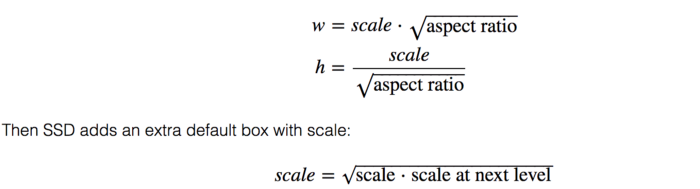

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**Matching strategy:**

SSD predictions are classified as positive matches or negative matches. SSD only uses positive matches in calculating the localization cost (the mismatch of the boundary box). During training we need to determine which default boxes correspond to a ground truth detection and train the network accordingly. For each ground truth box we are selecting from default boxes that vary over location, aspect ratio and scale. We begin by matching each ground truth box to the default box with the best overlap. We then match default boxes to
any ground truth with overlap higher than a threshold (0.5). This simplifies the
learning problem, allowing the network to predict high scores for multiple overlapping default boxes rather than requiring it to pick only the one with maximum overlap.


Here is an example of how SSD combines multi-scale feature maps and default boundary boxes to detect objects at different scale. The dog below matches one default box (in red) in the 4 × 4 feature map layer, but not any default boxes in the higher resolution 8 × 8 feature map. The cat which is smaller is detected only by the 8 × 8 feature map layer in 2 default boxes (in blue).

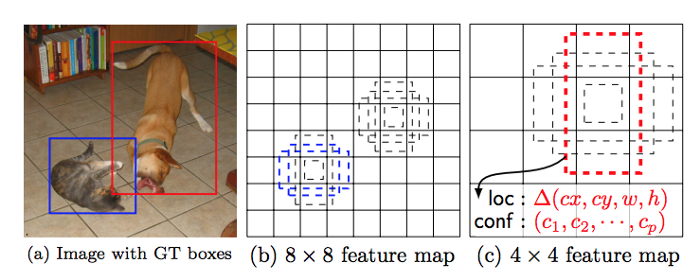

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

# **Loss function**


**The localization loss** is the mismatch between the ground truth box and the predicted boundary box. SSD only penalizes predictions from positive matches. We want the predictions from the positive matches to get closer to the ground truth. Negative matches can be ignored.

![](https://drive.google.com/uc?export=view&id=13xXNv5-BhbW-a_5iXDne51cqXo4vPheR)

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**The confidence loss** is the loss in making a class prediction. For every positive match prediction, we penalize the loss according to the confidence score of the corresponding class. For negative match predictions, we penalize the loss according to the confidence score of the class “0”: class “0” classifies no object is detected.


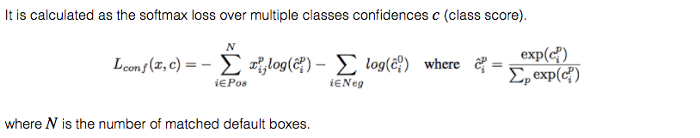

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**The final loss function is computed as:**


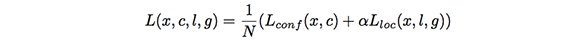

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

where N is the number of positive match and α is the weight for the localization loss.

## **Inference using Non-Max Suppression**


SSD makes many predictions (8732) for a better coverage of location, scale and aspect ratios, more than many other detection methods. However, many predictions contain no object. Therefore, any predictions with class confidence scores lower than 0.01 will be eliminated. The different predictions for an object evaluated at different scales will be finally assessed to label the object with the class it matches the most and the corresponding bounding box offset values with respect to the default box will also be provided at the output.

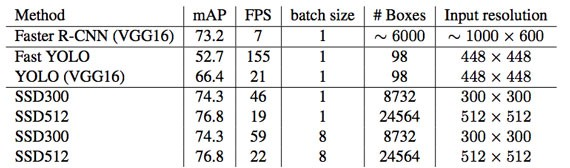

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

## **Experimental Results and Training Data Sets:**

The model is trained using SGD with initial learning rate 0.001 , 0.9 momentum, 0.0005 weight decay, and batch size 32. Using a Nvidia Titan X on VOC2007 test, SSD achieves 59 FPS with mAP 74.3% on VOC2007 test, vs. Faster R-CNN 7 FPS with mAP 73.2% or YOLO 45 FPS with mAP 63.4%.

Below is the accuracy comparison for different methods. For SSD, the image size is 300 × 300 or 512 × 512. 

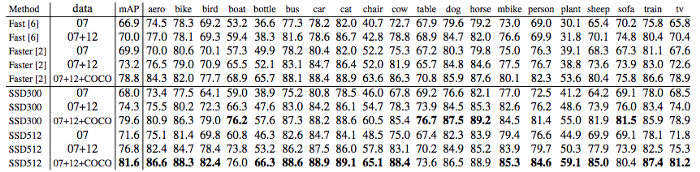

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

# **MoblieNetV1 replaces VGG16 as a base model in SSD:**
MobileNetV1 uses depthwise separable convolution for extracting feature maps which is comparitively lighter and faster than VGG16.


**Single Shot MultiBox Detector (MobileNet + SSD)**





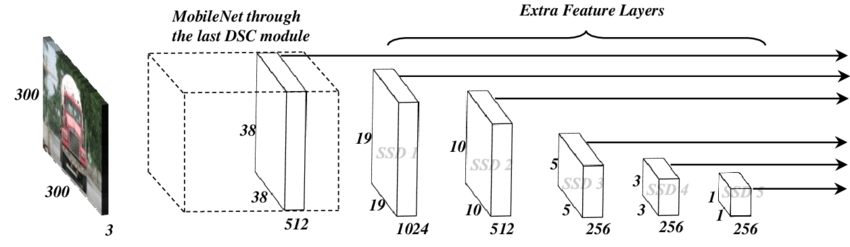


Image Source: [Single Shot MultiBox Detector (MobileNet + SSD)](https://www.researchgate.net/figure/mobileNet-SSD-network-architecture_fig3_332553794)


**Depthwise separable convolution** It reduces the model size and complexity and is particularly useful for mobile and embedded vision applications.
**It consists of two parts that replace normal convolution to reduce computation with a small accuracy trade-off** : 

* Depthwise convolution is the channel-wise DK×DK spatial convolution. Suppose in the figure above, we have 5 channels, then we will have 5 DK×DK spatial convolution.
* Pointwise convolution actually is the 1×1 convolution to change the dimension.

As a result of this we are able to achieve : 
1. Smaller model size: Fewer number of parameters
2. Lesser complexity: Fewer Multiplications and Additions (Mult-Adds)



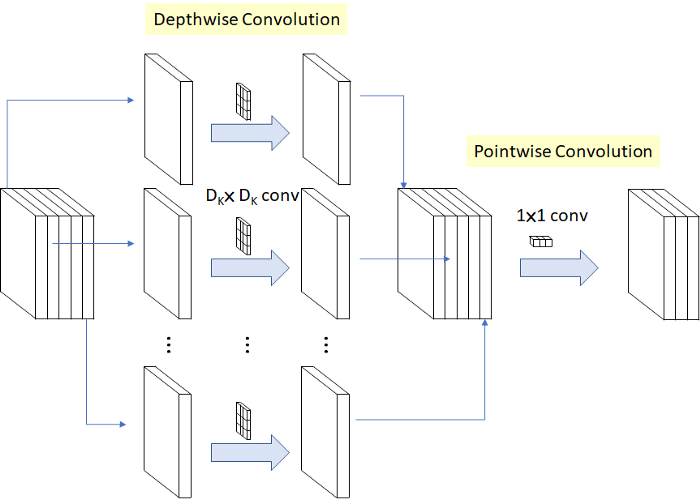

Image Source : [MobileNetV2 — Light Weight Model](https://towardsdatascience.com/review-mobilenetv2-light-weight-model-image-classification-8febb490e61c)


With above operation, the operation cost is:


Depthwise Separable Convolution Cost: Depthwise Convolution Cost (Left), Pointwise Convolution Cost (Right)

where M: Number of input channels, N: Number of output channels, DK: Kernel size, and DF: Feature map size.

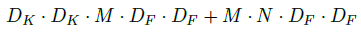

For standard convolution, convolution cost is:


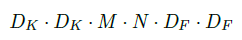



Thus, the computation reduction is:

Depthwise Separable Convolution Cost / Standard Convolution Cost

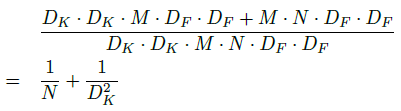



Image Source : [MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications](https://arxiv.org/pdf/1704.04861v1.pdf)

**Width Multiplier α is introduced to control the width of a layer** The role of the width multiplier α is to thin a network uniformly at each layer. For a given layer and width multiplier α, the number of input channels M becomes αM and the number of output channels N becomes αN.
The computational cost of a depthwise separable convolution with width multiplier α is:

![](https://drive.google.com/uc?export=view&id=1xselOGJdgIPo8h1b2YcuYRaFV51f8w0c)

α is between 0 to 1.Accuracy drops off smoothly until α=0.25.

**Resolution Multiplier ρ is introduced to control the input image**
We apply this to the input image and the internal representation of
every layer is subsequently reduced by the same multiplier ρ. The computational cost becomes:



![](https://drive.google.com/uc?export=view&id=18S_SM_9jGMSnX120P2EWC0FlfawBmpTY)

where ρ is between 0 to 1 and the input resolution is 224, 192, 160, and 128. When ρ=1, it is the baseline MobileNet.
Accuracy drops off smoothly across resolution from 224 to 128.

Image Source : [MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications](https://arxiv.org/pdf/1704.04861v1.pdf)

**In the above version of MobileNet which is called MobileNetV1**, Depthwise Separable Convolution was introduced which dramatically reduced the computational cost and model size of the network, which is suitable for mobile devices.

**In MobileNetV2, a better module is introduced with inverted residual structure.** Non-linearities in narrow layers are removed this time. With MobileNetV2 as backbone for feature extraction, state-of-the-art performances are achieved for object detection and semantic segmentation.

# **MobileNetV2 replaces MobileNetV1 as a base model in SSD:**


**Comparison MobileNetV1 vs MobileNetV2**

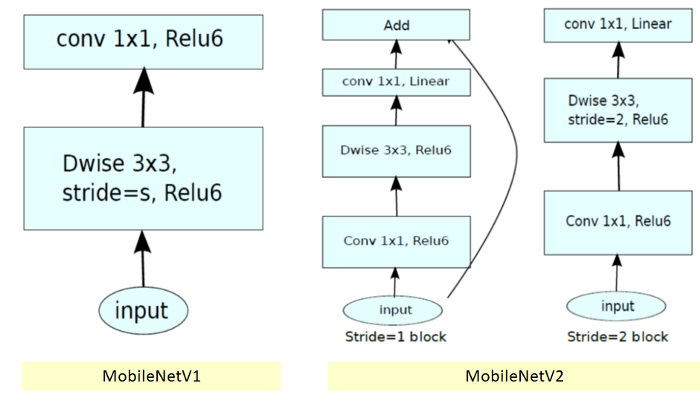


Image Source : [MobileNetV2 — Light Weight Model](https://towardsdatascience.com/review-mobilenetv2-light-weight-model-image-classification-8febb490e61c)

In MobileNetV2 a better module is introduced with inverted residual structure. Non-linearities in narrow layers are removed this time. With MobileNetV2 as backbone for feature extraction, state-of-the-art performances are also achieved for object detection and semantic segmentation.

**In MobileNetV1,** 

There are 2 layers and ReLU6 is used here for comparison.
* The first layer is called a depthwise convolution 
* The second layer is a 1×1 convolution, called a pointwise convolution


**In MobileNetV2,**

There are two types of blocks. 
* One is residual block with stride of 1. 
* Another is a block with stride of 2 for downsizing.

There are 3 layers for both types of blocks.
* The first layer is 1×1 convolution with ReLU6.
* The second layer is the depthwise convolution.
* The third layer is another 1×1 convolution but without any non-linearity. 


# **MobileNetV2 Overall Architecture**



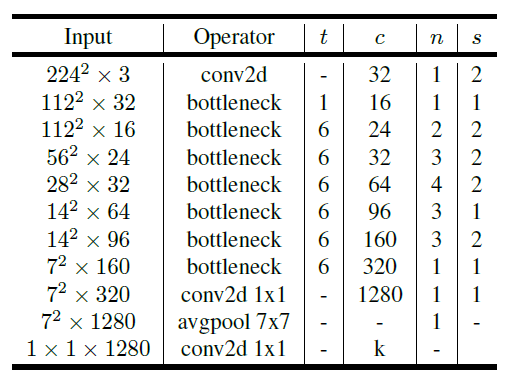

where t: expansion factor, c: number of output channels, n: repeating number, s: stride. 3×3 Kernels are used for spatial convolution.


# **Experimental Results and Training Data Sets:**


**Object Detection**

SSD is evaluated
with 300 input resolution (SSD 300) and Faster-RCNN is
compared with both 300 and 600 input resolution (FasterRCNN 300, Faster-RCNN 600). The Faster-RCNN model
evaluates 300 RPN proposal boxes per image. The models
are trained on COCO train+val excluding 8k minival images. **We can see from the below results that Mobilenet achieves a comparable accuracy with far less parameters and Mult-Adds.**



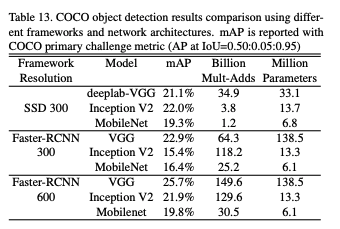

Image Source : [MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications](https://arxiv.org/pdf/1704.04861v1.pdf)

Many other datasets are also tried to prove the effectiveness of MobileNet:

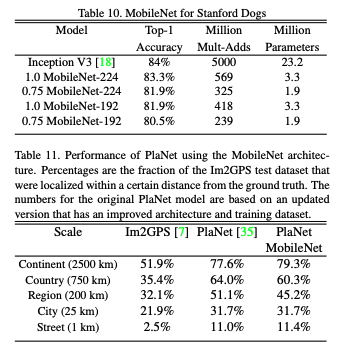

Image Source : [MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications](https://arxiv.org/pdf/1704.04861v1.pdf)


## **Replication:**


We were provided with three notebooks as baseline code which we were able to execute with minor changes and observe the application of the SSD model. 


1.   Object Detection tutorial : [Link to Replicated Notebook](https://colab.research.google.com/drive/16yMFZF1rfQnFw438r70VloaU8it9Cet5?usp=sharing)
   * This colab notebook demonstrates use of a Tensor Flow - Hub module trained to perform object detection.
   * Major components of the notebook:

      > Notebook imports various TF modules, Numpy,Matplotlib, Python Imaging Library functions and modules 

      >Notebook has helper functions for downloading images and for visualization.

      >Notebook loads a public image from Open Images v4, save locally, and displays it

      > Notebook has capability to pick an object detection module (FasterRCNN+InceptionResNet or SSD+MobileNetV2) and apply it on the downloaded image. 
      > Notebook also has the capablity to display inference time for each object detection task

Below is the output of object detection task performed by SSD+MobileNetV2 model. We can see the we have got bounding boxes with labels and scores associated with each object detected in the image.


We made no changes to this notebook for executing it. However, we have used this notebook for our extension and the corresponding code changes we made have been explained in the extension section.






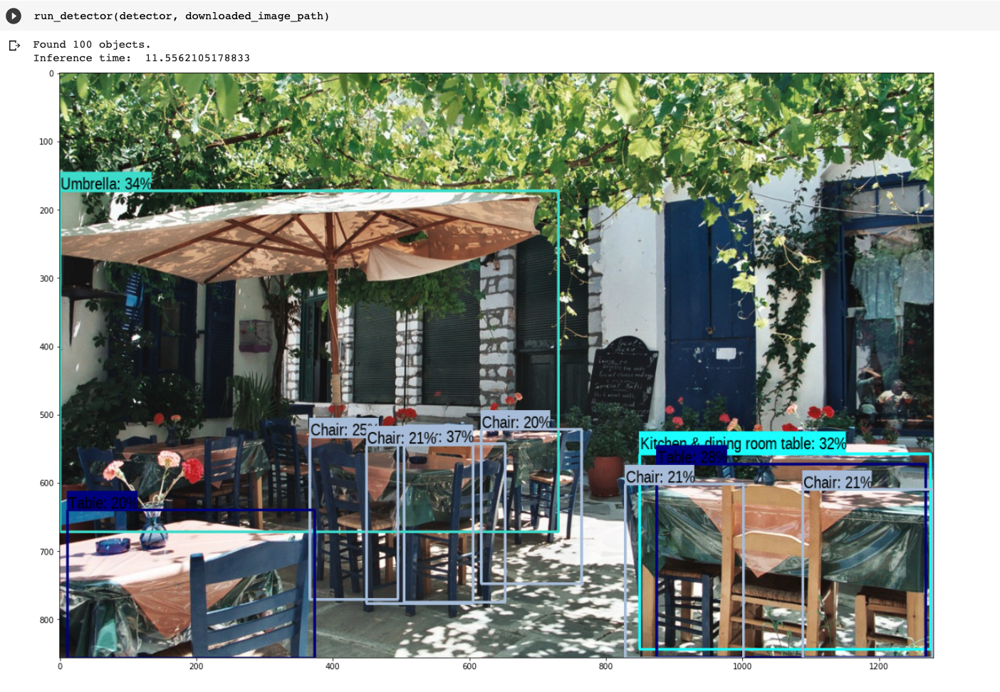


2.   Object Detection with SSD on Video: [Link to Replicated Notebook](https://colab.research.google.com/drive/1EfAr2ciC5-ivnmrf7BKSne8FLHgC3_Qz?usp=sharing)

   * This notebook uses a PyTorch port of SSD: Single Shot MultiBox Detector to detect objects on a given youtube video.
   * Major components of the notebook:
     > Notebook imports various TF modules, Numpy, Matplotlib libraries 

      > Notebook downloads the SSD300 pretrained model

      >It prepares model for detection by fixing some errors present in the model and calls build_ssd function of ssd module which is the constructor to build the architecture of single shot multibox architecture and tests the given video on the model.

We made changes to this notebook for changing library versions.





Below is the output of object detection task performed by the SSD model. We can see the we have got bounding boxes with labels and scores associated with each object detected in the test video. This notebook was useful in observing the application of SSD in fast object detection.

![](https://drive.google.com/uc?export=view&id=1crNQ7P5c1D5KpxDkuQ0VKxWSqbYHN1Hv)

![](https://drive.google.com/uc?export=view&id=1H4VVWnxqEIzJJ7a7I6s8cAPIW188PcTl)

<!-- 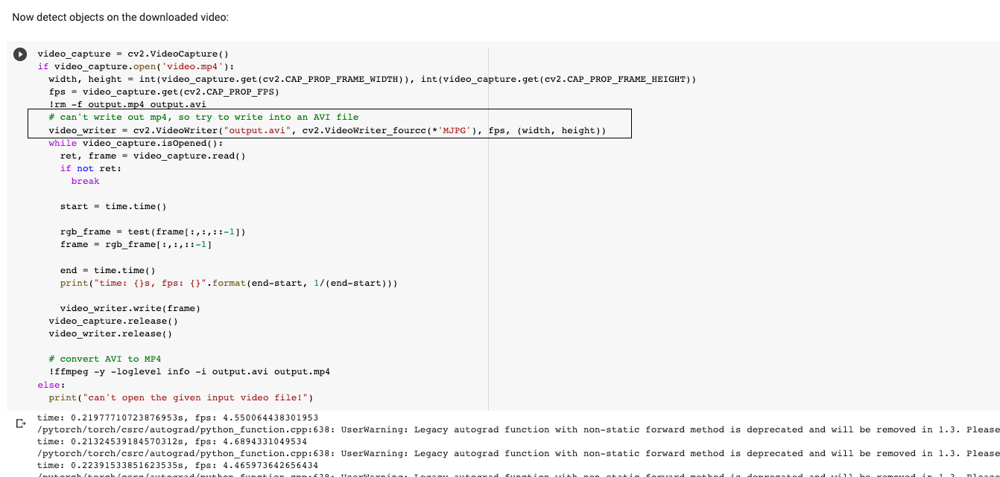 -->



3.  Training a MobileNet-SSD based model for object detection on a custom dataset : [Link to Replicated Notebook](https://colab.research.google.com/drive/1kS51I7a4T_BMN-GuR1cuhlYti8prhOlP?usp=sharing)
  * This notebook demonstrates how to train a MobileNet-SSD object detection model using the TensorFlow 1.5 Object Detection API.

   * Major components of the notebook:
    > **Data:**
This notebook uses an open source blood cell dataset called BCCD (Blood Cell Count and Detection). This dataset contains 364 images (and 4888 annotations!) and is hosted publicly on Roboflow.

     >**Model Selection for Training:**
This notebook performs training of a MobileNetSSDv2 model (single shot detector) and also provides the option to train the Faster RCNN model

     >**Inference:** This notebook run inference directly in the notebook, and on three test images contained in the "test" folder from our GitHub repo.
When adapting to a custom dataset, we have to add test images to the test folder located at tensorflow-object-detection/test.

     >**Configs and Hyperparameters:** This notebook supports a variety of models, more pretrained model can be found at [Tensorflow detection model zoo: COCO-trained models](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md#coco-trained-models), as well as their pipline config files in [object_detection/samples/configs/](https://github.com/tensorflow/models/tree/master/research/object_detection/samples/configs). It provides the capability to configure these models as per the requirements and train accordingly.

     >It downloads base model and configures the training pipline and then performs training on the custom dataset. Once training is complete,it extracts the newly trained inference graph, which is used to perform the object detection. 

     >It also gives the option to download frozen inference graph for later use.

     > Then it performs testing with images in repository tensorflow-object-detection/test directory.To test with custom images, we need to place our images inside the test directory.
     > It performs object detection using run_inference_for_single_image method. This method uses trained model to perform inference and ouputs the bounding boxes, labels and scores.

     



    

Below is the output of object detection task performed by SSD+MobileNetV2 model. We can see the we have got bounding boxes with labels and scores associated with each blood cell detected in the test image.


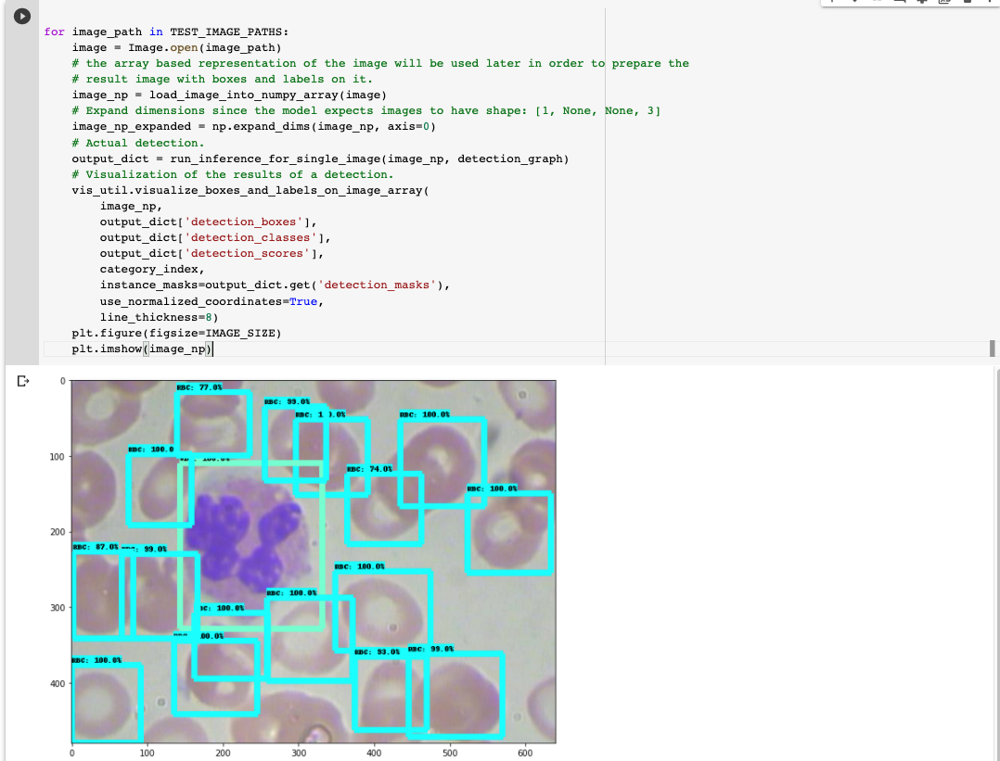

##**Extension:**

## Comparing SSD-MobilenetV2 with Faster R-CNN with respect to inference time, memory usage and accuracy : 

# Imports and function definitions : 

In [ ]:

# For running inference on the TF-Hub module.
import tensorflow as tf

import tensorflow_hub as hub

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

#for drawing plots
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# For measuring the inference time.
import time

# Print Tensorflow version
print(tf.__version__)

# Check available GPU devices.
print("The following GPU devices are available: %s" % tf.test.gpu_device_name())

2.3.0
The following GPU devices are available: 


# Changes we made to load the memory profiler : 

In [ ]:
!pip install -U memory_profiler
%load_ext memory_profiler



  Created wheel for memory-profiler: filename=memory_profiler-0.58.0-cp36-none-any.whl size=30181 sha256=75c33f4edceeca2605403d570f4ff2f02cb4f0e2c8cc45b32e908e3bcdffb6bc
  Stored in directory: /root/.cache/pip/wheels/02/e4/0b/aaab481fc5dd2a4ea59e78bc7231bb6aae7635ca7ee79f8ae5
Successfully built memory-profiler


# Helper functions for downloading images and for visualization : 



In [ ]:
def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.imshow(image)


def download_and_resize_image(url, new_width=256, new_height=256,
                              display=False):
  _, filename = tempfile.mkstemp(suffix=".jpg")
  response = urlopen(url)
  image_data = response.read()
  image_data = BytesIO(image_data)
  pil_image = Image.open(image_data)
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
  pil_image_rgb = pil_image.convert("RGB")
  pil_image_rgb.save(filename, format="JPEG", quality=90)
  print("Image downloaded to %s." % filename)
  if display:
    display_image(pil_image)
  return filename


def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):
  """Adds a bounding box to an image."""
  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

  # If the total height of the display strings added to the top of the bounding
  # box exceeds the top of the image, stack the strings below the bounding box
  # instead of above.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  # Each display_str has a top and bottom margin of 0.05x.
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = top + total_display_str_height
  # Reverse list and print from bottom to top.
  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill="black",
              font=font)
    text_bottom -= text_height - 2 * margin


def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
  """Overlay labeled boxes on an image with formatted scores and label names."""
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                              25)
  except IOError:
    print("Font not found, using default font.")
    font = ImageFont.load_default()

  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])
      display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                     int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
      draw_bounding_box_on_image(
          image_pil,
          ymin,
          xmin,
          ymax,
          xmax,
          color,
          font,
          display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

## Apply module : 

Load a public image from Open Images v4, save locally, and display.

Image downloaded to /tmp/tmptdpojg0s.jpg.


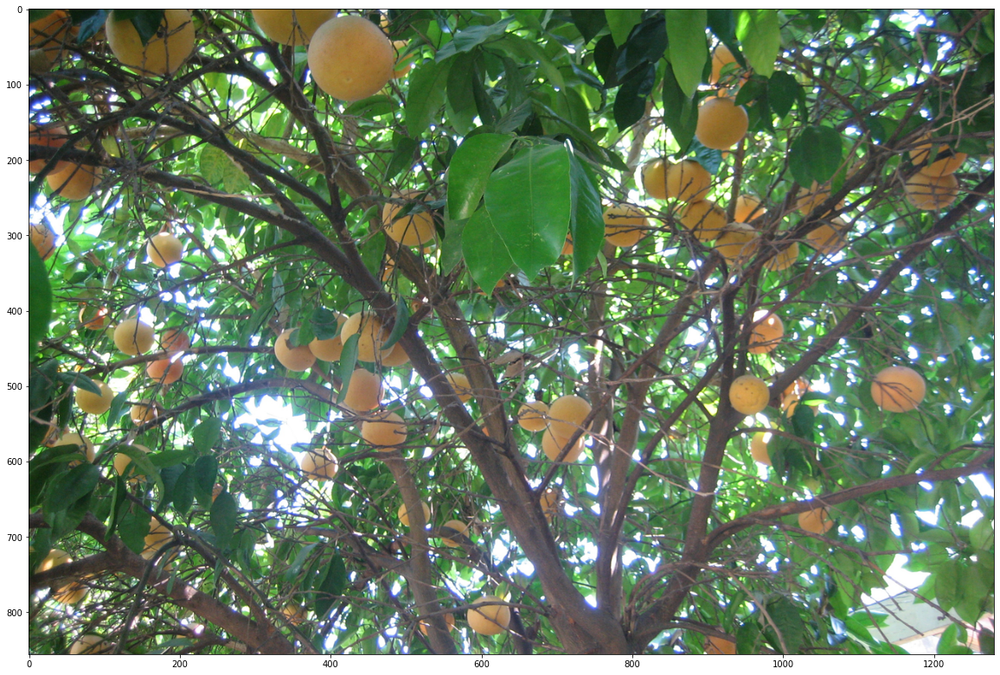

In [ ]:
#Source:(https://farm6.staticflickr.com/)
image_url =   "https://farm6.staticflickr.com/1038/825874698_acb51b52bd_o.jpg"#@param
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)

Pick an object detection module and apply on the downloaded image. Modules for comparision:
* **FasterRCNN+InceptionResNet V2**: high accuracy,
* **ssd+mobilenet V2**: small and fast.

In [ ]:
module_handleSSD = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1" #@param ["https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1", "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"]
module_handleRCNN = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1" #@param ["https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1", "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"]
detectorSSD = hub.load(module_handleSSD).signatures['default']
detectorRCNN = hub.load(module_handleRCNN).signatures['default']

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [ ]:
def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

In [ ]:
def run_detectorSSD(detectorSSD, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = detectorSSD(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])
  
  display_image(image_with_boxes)

def run_detectorRCNN(detectorRCNN, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = detectorRCNN(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])

  display_image(image_with_boxes)

# Detection using SSD+Mobilenet : 

SSD
Found 100 objects.
Inference time:  6.15379786491394
peak memory: 5247.19 MiB, increment: 12.93 MiB


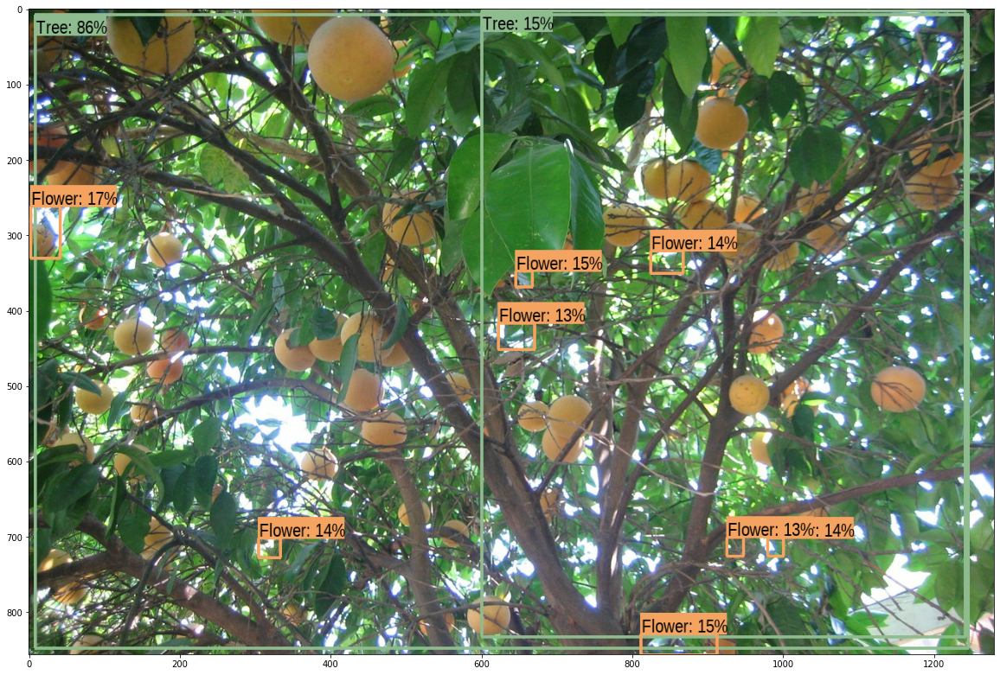

In [ ]:
print('SSD')
%memit run_detectorSSD(detectorSSD, downloaded_image_path)


# Detection using Faster R-CNN : 

RCNN
Found 100 objects.
Inference time:  60.55438542366028
peak memory: 5773.10 MiB, increment: 525.91 MiB


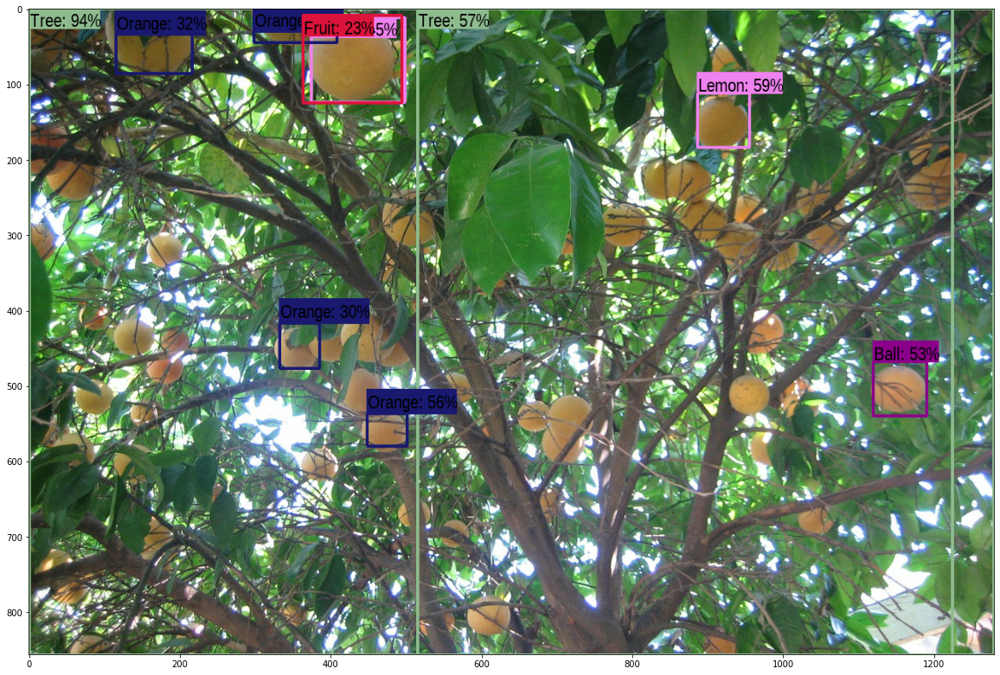

In [ ]:
print('RCNN')
%memit run_detectorRCNN(detectorRCNN, downloaded_image_path)

#Plotting results for accuracy : 

# SSD+Mobilenet : 

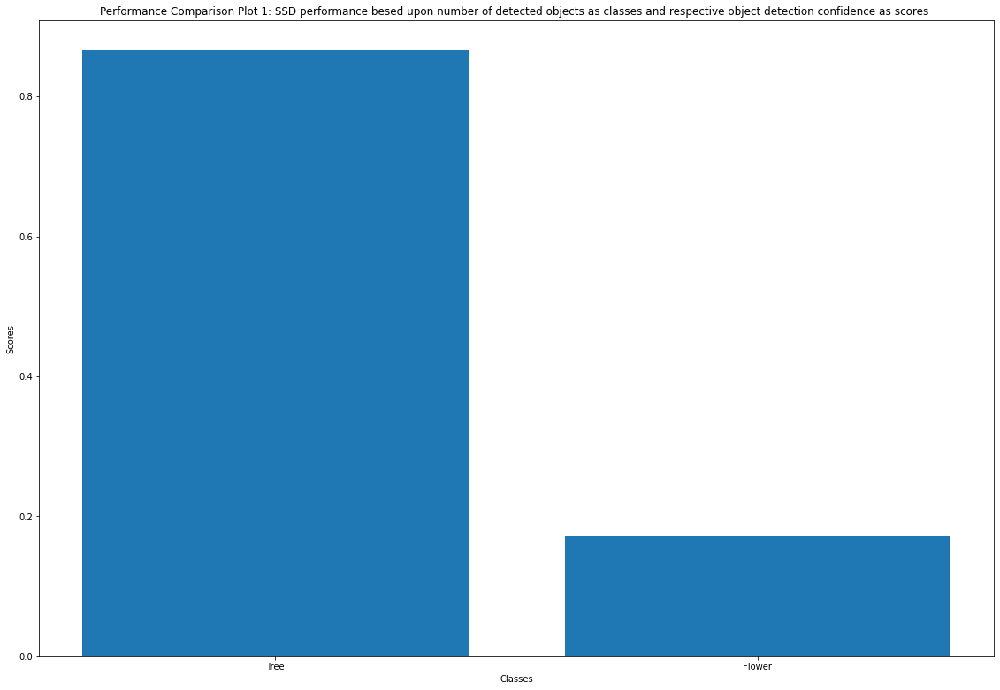

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
img = load_img(downloaded_image_path)
converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
result = detectorSSD(converted_img)


fig = plt.figure()
ax = fig.add_axes([0,0,2.5,2.5])
classPlot =result["detection_class_entities"].numpy()

scoresPlot = result["detection_scores"].numpy()

ax.bar(classPlot,scoresPlot)
ax.set_ylabel('Scores')
ax.set_xlabel('Classes')

plt.title("Performance Comparison Plot 1: SSD performance besed upon number of detected objects as classes and respective object detection confidence as scores ")
plt.show()




# Faster R-CNN : 

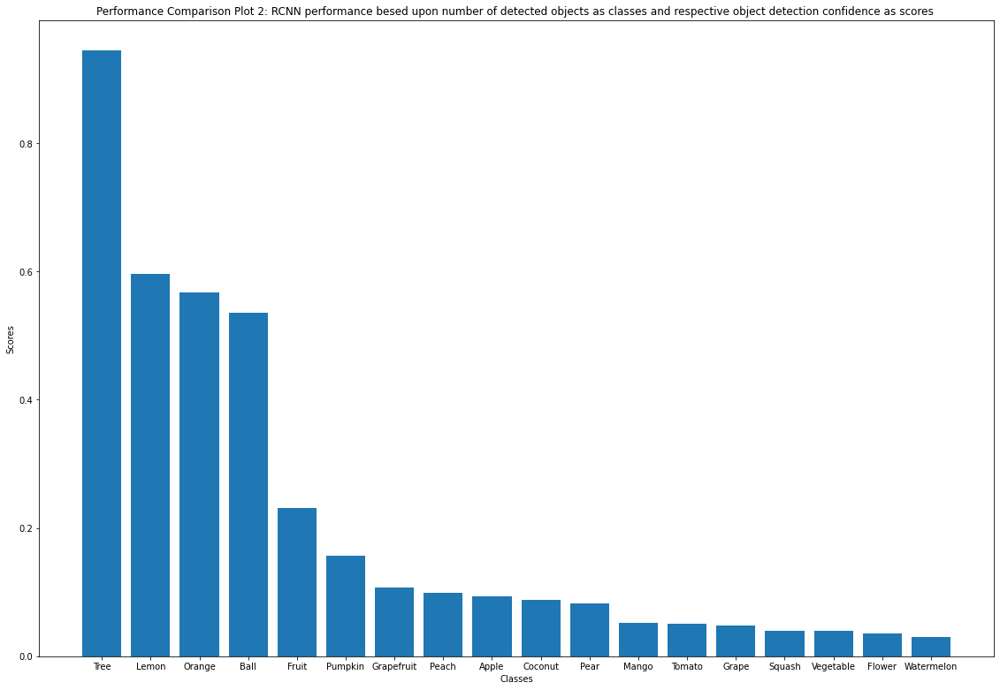

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
img = load_img(downloaded_image_path)
converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
result = detectorRCNN(converted_img)


fig = plt.figure()
ax = fig.add_axes([0,0,2.5,2.5])
langs =result["detection_class_entities"].numpy()

students = result["detection_scores"].numpy()

ax.bar(langs,students)
plt.title("Performance Comparison Plot 2: RCNN performance besed upon number of detected objects as classes and respective object detection confidence as scores ")
ax.set_ylabel('Scores')
ax.set_xlabel('Classes')
plt.show()




# **Accuracy Comparison:**
 We can see in the above comparison that Faster R-CNN performed better in terms of detecting small objects accurately  and SSD performed better in terms of faster inference speed (Please refer to the box above each image detection above for inference time). 

In Plot 1, we can see that SSD only detected the large object Tree correctly. However, it was unable to detect the lemons correctly but classified them as flowers instead.
In Plot 2, we can see that Faster R-CNN performed better in terms of detecting objects more accurately. It inferred almost 18 classes and then utilized that result to detect both large (Tree) and small (Lemon) objects correctly.

SSD is unable to detect smaller objects because it picks features from the inner convolutional layers. We can understand that as an image passes through subsequent feature extraction convolutional layers, it transforms from a high resolution to a low resolution. The inner layers are able to provide finer details, but by the time the image reaches these layers, small scale objects are lost in the downsampling. Intuitively, we can understand that while these layers help SSD detect different types of large and medium objects, small object features get lost in the process.

# **Inference Time and Memory Comparison:**

SSD is a clear winner due to its inherent simpler architecture and method in terms of memory usage and inference speed.

In the above image detection output windows for both SSD and Faster R-CNN, we can see that SSD took only 6.15379786491394 seconds whereas R-CNN took
60.55438542366028 seconds for performing object detection on same image. SSD eliminates the region proposal step and uses a single network to speed up processing (Mobilenet helps further).

When we loaded the two models for this notebook, we observed that the model size for Faster R-CNN is 228 MB and for SSD it was simply 50 MB.
In terms of memory usage during inference, due to SSD+Mobilenet's less complex and lighweight model architecture,there was only 12.93 MiB of memory increment when it started inferring objects in the image. In case of RCNN the memory usage increment was 525.91 MiB. This shows that SSD is suitable for mobile and embedded vision applications where memory is the limiting factor.



### More images
We performed object detection on some additional images with time and memory usage tracking.


In [ ]:
image_urls = [
  # Source:(https://farm4.staticflickr.com/)
  "https://farm4.staticflickr.com/2430/3816987115_51c9ecb6a6_o.jpg",
  # Source: (https://media.guestofaguest.com/)
  "https://media.guestofaguest.com/t_article_content/gofg-media/2017/03/1/48517/bamontes_.jpg", 
  # Source:(https://c8.staticflickr.com/)
  "https://c8.staticflickr.com/9/8747/17196717922_7d863775be_o.jpg",
  # Source:(https://farm4.staticflickr.com/)
  "https://farm4.staticflickr.com/2430/3816987115_51c9ecb6a6_o.jpg",

  ]

def detect_imgSSD(image_url):
  start_time = time.time()
  image_path = download_and_resize_image(image_url, 640, 480)
  run_detectorSSD(detectorSSD, image_path)
  end_time = time.time()
def detect_imgRCNN(image_url):
  start_time = time.time()
  image_path = download_and_resize_image(image_url, 640, 480)
  run_detectorRCNN(detectorRCNN, image_path)
  end_time = time.time()

SSD
Image downloaded to /tmp/tmp5bcey3o3.jpg.
Found 100 objects.
Inference time:  0.30307507514953613
peak memory: 5953.96 MiB, increment: 0.22 MiB

RCNN
Image downloaded to /tmp/tmp7s08ot30.jpg.
Found 100 objects.
Inference time:  31.465728998184204
peak memory: 5955.02 MiB, increment: 1.05 MiB


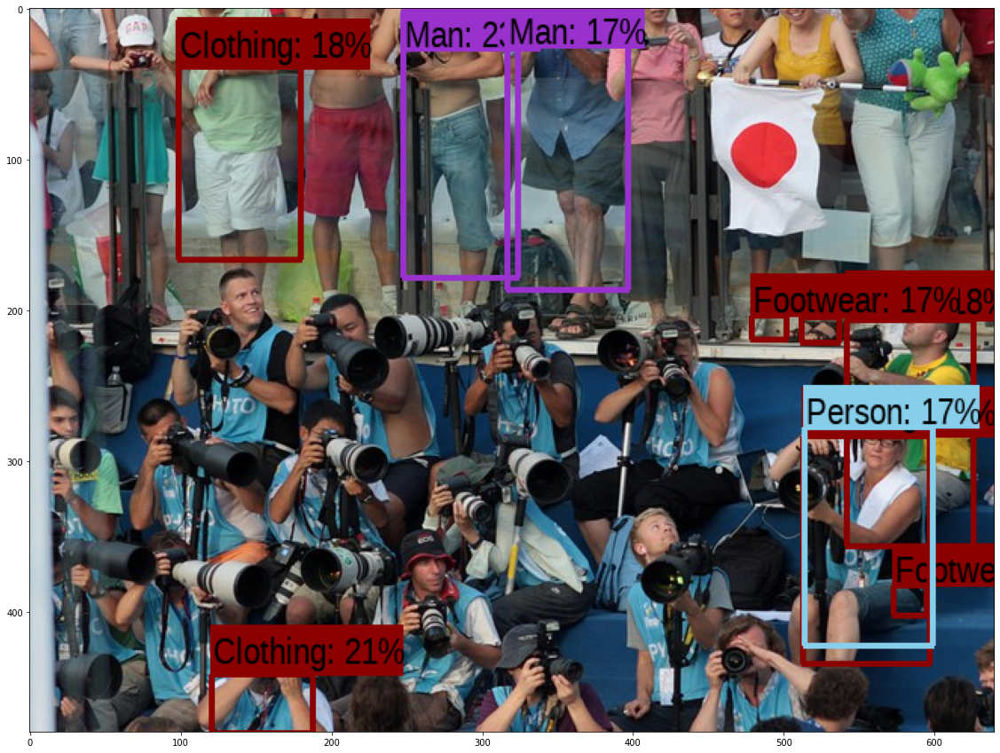

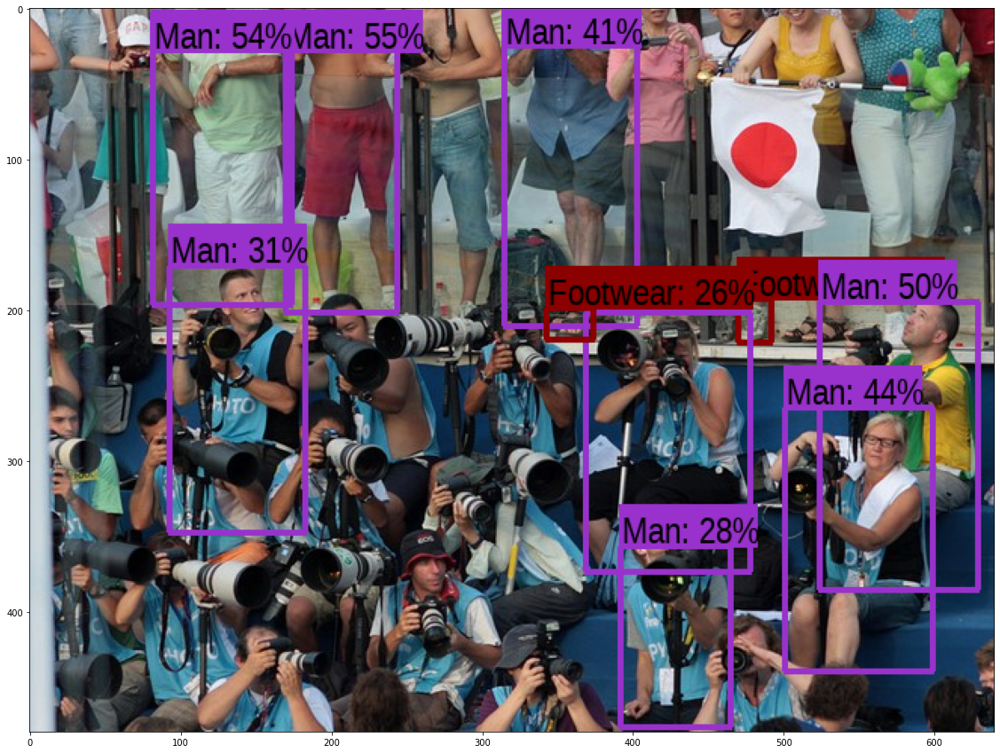

In [ ]:
print('SSD') 
%memit detect_imgSSD(image_urls[0])

print('\nRCNN') 
%memit detect_imgRCNN(image_urls[0])


SSD
Image downloaded to /tmp/tmpkpp2uy_4.jpg.
Found 100 objects.
Inference time:  0.3326449394226074
peak memory: 5954.96 MiB, increment: 0.01 MiB

RCNN
Image downloaded to /tmp/tmp78qs8mof.jpg.
Found 100 objects.
Inference time:  31.553935050964355
peak memory: 5954.96 MiB, increment: 0.00 MiB


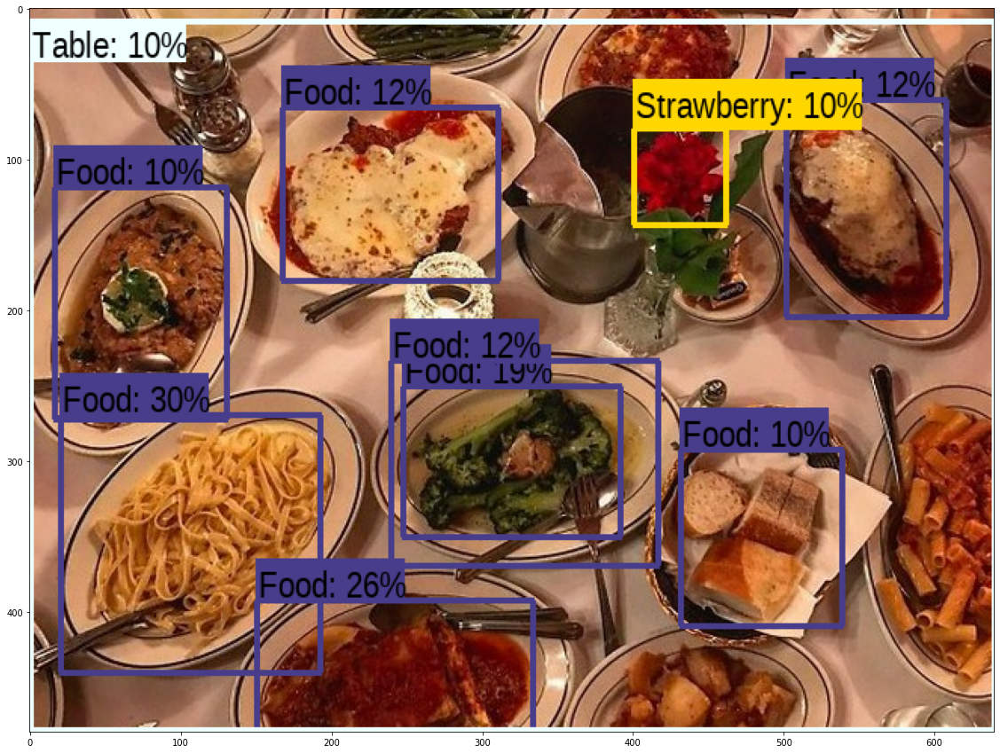

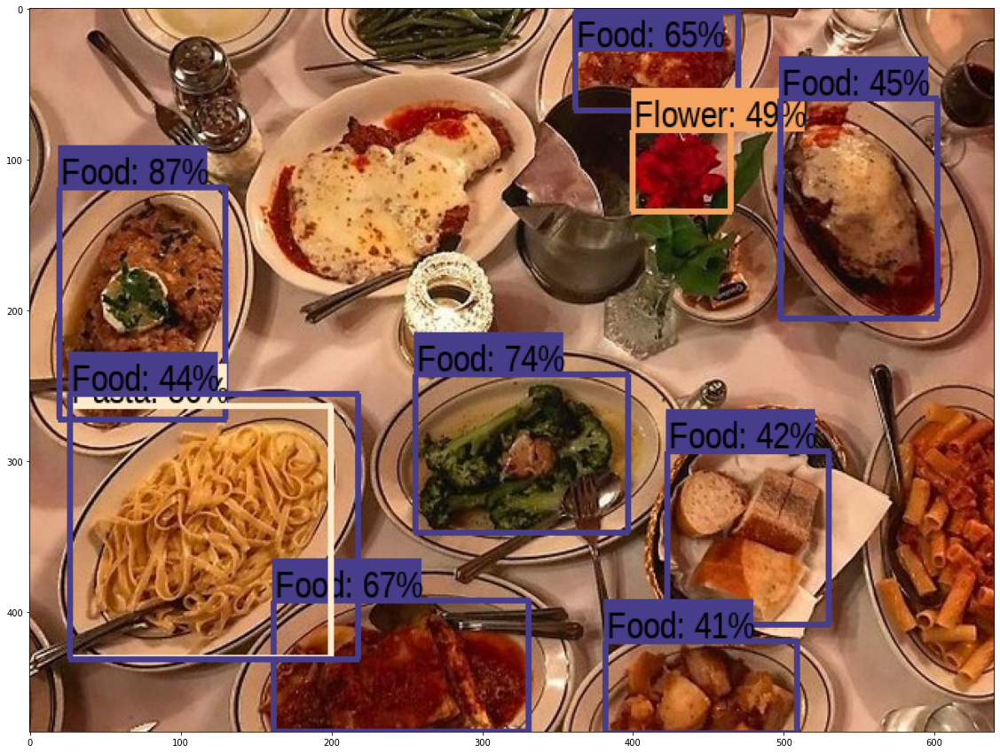

In [ ]:
print('SSD')  
%memit detect_imgSSD(image_urls[1])
print('\nRCNN')
%memit detect_imgRCNN(image_urls[1])

SSD
Image downloaded to /tmp/tmpi9anqg11.jpg.
Found 100 objects.
Inference time:  0.2985098361968994
peak memory: 5955.05 MiB, increment: 0.09 MiB

RCNN
Image downloaded to /tmp/tmp2_c9_qsh.jpg.
Found 100 objects.
Inference time:  31.49728488922119
peak memory: 5954.97 MiB, increment: 0.01 MiB


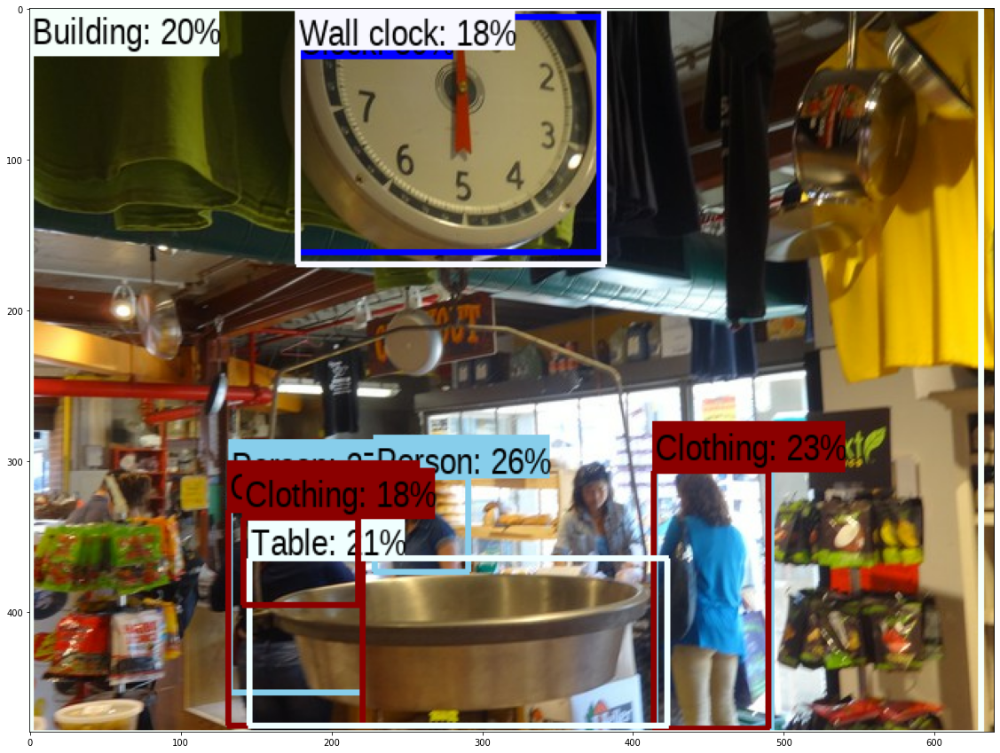

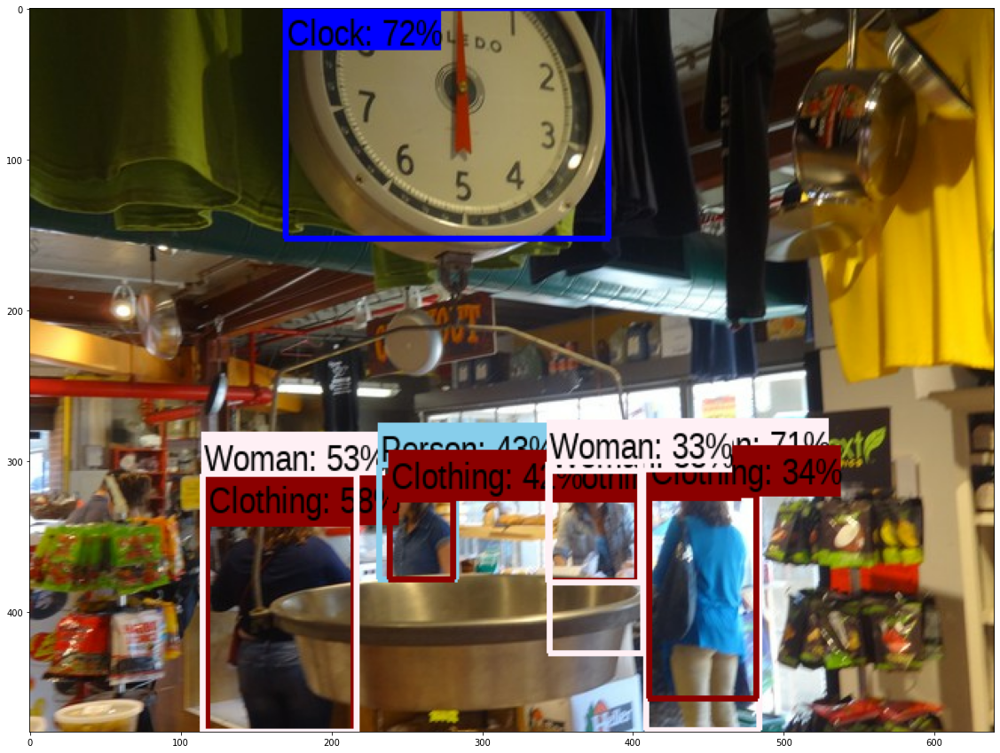

In [ ]:
print('SSD') 
%memit detect_imgSSD(image_urls[2])
print('\nRCNN') 
%memit detect_imgRCNN(image_urls[2])

## **Conclusion:**

In conclusion, SSD with MobileNet seems to be a good balance between speed and accuracy as we are able to use it for fast object detection in a video that we executed in our notebook replication and the accuracy trade-off is very little. However, it may not be that accurate when we compare its performance with the performance of Faster-RCNN on small sized objects. At large sizes, SSD seems to perform similarly to Faster-RCNN. However,the accuracy gap widens when the object size is small.




#**Citations:**

**Research Papers:**

SSD:Single Shot MultiBox Detector (https://arxiv.org/pdf/1512.02325.pdf)

MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications (https://arxiv.org/pdf/1704.04861v1.pdf)


**Articles for Conceptual Understanding :**

https://jonathan-hui.medium.com/what-do-we-learn-from-region-based-object-detectors-faster-r-cnn-r-fcn-fpn-7e354377a7c9
https://towardsdatascience.com/review-mobilenetv2-light-weight-model-image-classification-8febb490e61c
https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06



